In [1]:
import os
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from PIL import Image
from skimage.io import imread
import cv2


# <b>IMAGE PROCESSSING</b>

<h2>Reshaping dimensions so we can start processing arrays. </h2>

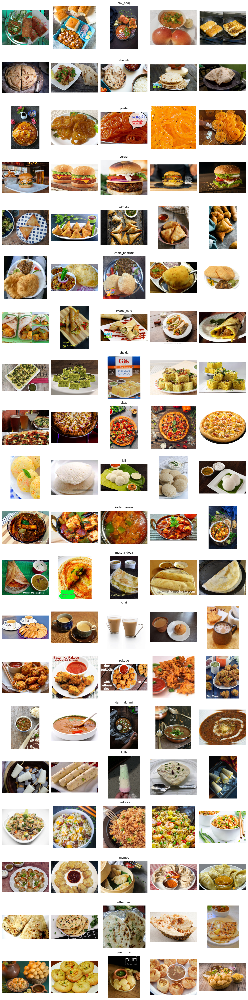

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Define the base path
base_path = '/input/indian-food-classification/dataset/Dataset/train'

# Get all class directories
class_dirs = [d for d in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, d))]

# Number of classes and images per class
num_classes = len(class_dirs)
images_per_class = 5

# Create a figure with subplots
fig, axes = plt.subplots(num_classes, images_per_class, figsize=(15, num_classes * 3))

# Display 5 images per class
for i, class_dir in enumerate(class_dirs):
    class_path = os.path.join(base_path, class_dir)
    # Get all image files in the class directory
    image_files = [f for f in os.listdir(class_path) if os.path.isfile(os.path.join(class_path, f))]
    # Select the first 5 images
    selected_images = image_files[:images_per_class]

    # Display images in subplot
    for j, img_file in enumerate(selected_images):
        img_path = os.path.join(class_path, img_file)
        img = Image.open(img_path)
        axes[i, j].imshow(img)
        axes[i, j].axis('off')

    # Center the class label for each row
    axes[i, images_per_class // 2].set_title(class_dir, fontsize=12, pad=10)

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
img = plt.imread('../input/indian-food-classification/dataset/Dataset/train/burger/002.jpg')
dims = np.shape(img)
matrix = np.reshape(img, (dims[0] * dims[1], dims[2]))  # Flattening height and width for pixel-level analysis
print(np.shape(matrix))

(960000, 3)


Image shape ->  (800, 1200)
Color channels ->  3
Min color depth : 0, Max color depth 255


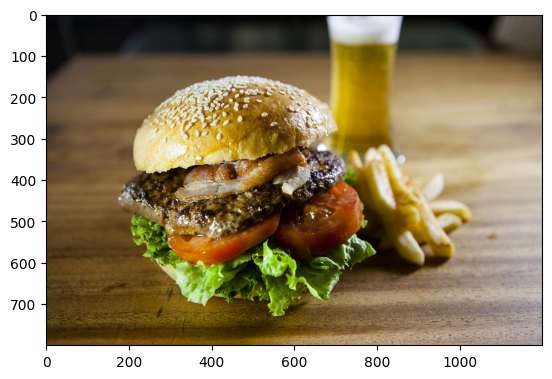

In [ ]:
# Display image and print relevant details
plt.imshow(img)
print("Image shape -> ", dims[:2])
print("Color channels -> ", dims[2])
print("Min color depth : {}, Max color depth {}".format(np.min(img), np.max(img)))

<h2>Plot for visualizing pixel intensities for RGB in color space</h2>

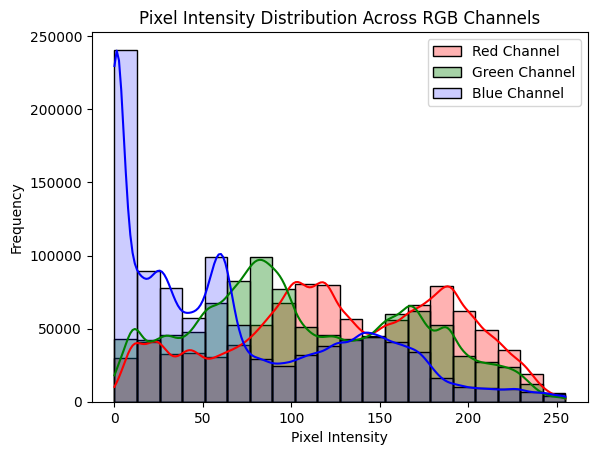

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot the distribution of pixel intensity for the Red, Green, and Blue channels
sns.histplot(matrix[:, 0], bins=20, color="red", kde=True, alpha=0.3, label='Red Channel')
sns.histplot(matrix[:, 1], bins=20, color="green", kde=True, alpha=0.35, label='Green Channel')
sns.histplot(matrix[:, 2], bins=20, color="blue", kde=True, alpha=0.2, label='Blue Channel')

# Add labels and title
plt.title('Pixel Intensity Distribution Across RGB Channels')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

# Add a legend to distinguish the channels
plt.legend()

# Show the plot
plt.show()


<h2>Plot for visualizing histogram between 2 color channel</h2>

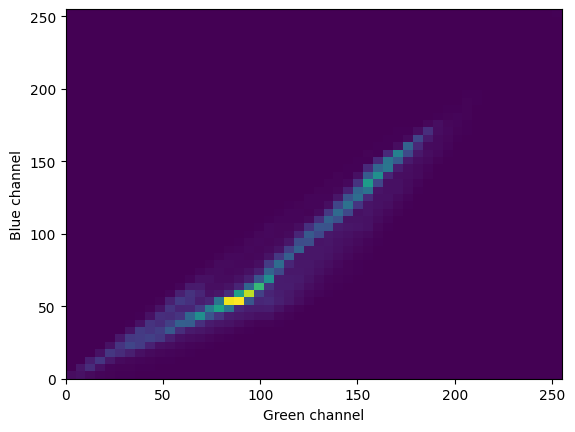

In [ ]:
_ = plt.hist2d(matrix[:,1], matrix[:,2], bins=(50,50))
plt.xlabel('Green channel')
plt.ylabel('Blue channel')
plt.show()

- <span style="font-size:18px;color:blue"><b>The pixels between green and blue bands are correlated (as evident from overlapping on above graph), and typically has visible imagery.</b></span>

- <span style="font-size:18px;color:blue"><b>Raw band differences will need to be scaled or thresholded </b></span>

<span style="font-size:15px;"><b>Image data consists of variations due to resolution differences between scenes, pixel intensities of an image and the environment around which the image was taken. This area of image processing is critical in today's time with the rise of Artificial intelligence.From motion detection to complex circuits in self driving car, the research requires tremendous amount of work and can be seen as widely growing areas of computer vision.</b><span>

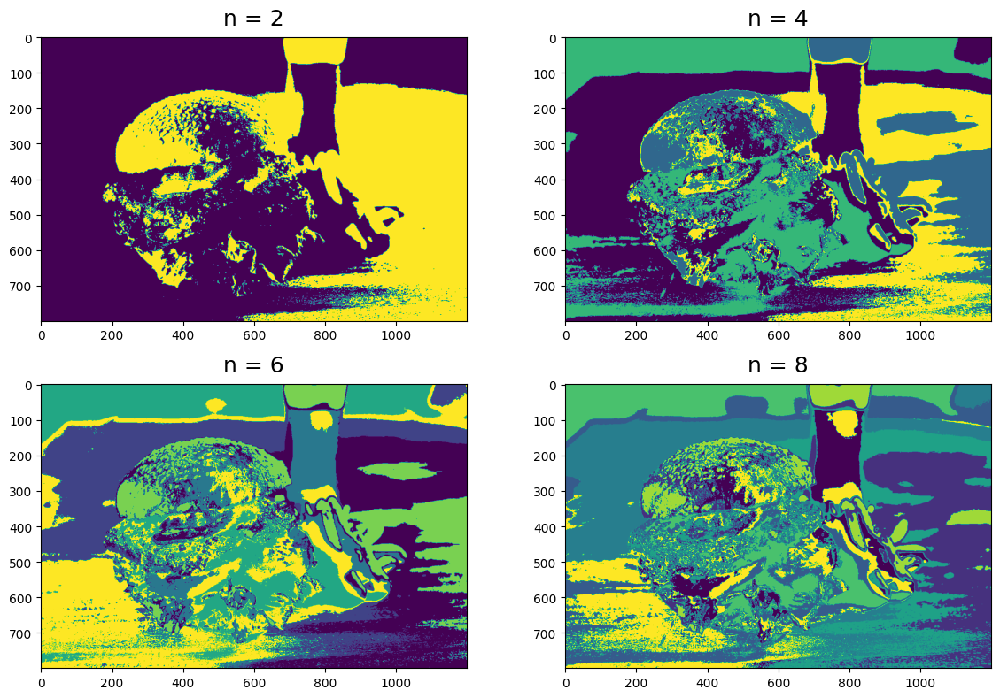

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import cluster

# Define the number of clusters to test (for K-Means clustering)
n_vals = [2, 4, 6, 8]
# Initialize the plot with a figure size of 12x8
plt.figure(1, figsize=(12, 8))
# Loop over each value of 'n' (number of clusters)
for subplot, n in enumerate(n_vals):

    # Initialize K-Means clustering with 'n' clusters
    kmeans = cluster.KMeans(n_clusters=n)
      # Apply K-Means to the reshaped image data (matrix), and get the cluster labels for each pixel
    clustered = kmeans.fit_predict(matrix)
    # Get the dimensions of the original image (height, width, channels)
    dims = np.shape(img)
    # Reshape the clustered result back to the original image dimensions (height x width)
    clustered_img = np.reshape(clustered, (dims[0], dims[1]))

    # Plot each segmented image in a 2x2 grid of subplots
    plt.subplot(2, 2, subplot + 1)
    plt.title(f"n = {n}", pad=10, size=18)  # Add a title for each subplot indicating the number of clusters
    plt.imshow(clustered_img)  # Display the clustered image

# Adjust layout for better visualization
plt.tight_layout()
# Show the plot
plt.show()


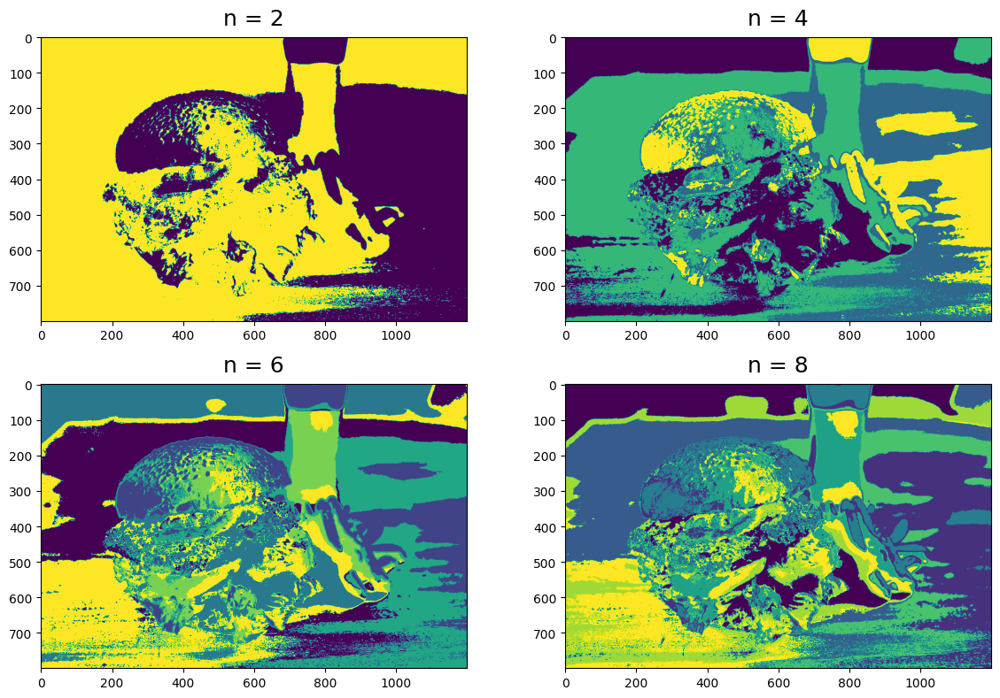

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import cluster
from PIL import Image

# Load the burger image
img = plt.imread('/input/indian-food-classification/dataset/Dataset/train/burger/002.jpg')  # Update with your actual burger image path

# Reshape the image for clustering
dims = np.shape(img)
matrix = np.reshape(img, (dims[0] * dims[1], dims[2]))  # Flatten the image

# Different values of n (clusters)
n_vals = [2, 4, 6, 8]

# Plotting the segmented images
plt.figure(1, figsize=(12, 8))

for subplot, n in enumerate(n_vals):
    kmeans = cluster.KMeans(n_clusters=n)
    clustered = kmeans.fit_predict(matrix)
    clustered_img = np.reshape(clustered, (dims[0], dims[1]))  # Reshape back to original dimensions

    # Plot each segmentation result
    plt.subplot(2, 2, subplot + 1)
    plt.title("n = {}".format(n), pad=10, size=18)
    plt.imshow(clustered_img, cmap='viridis')

plt.tight_layout()
plt.show()


<h2> Let's visualize the channel intensity for every cluster we just generated.</h2>

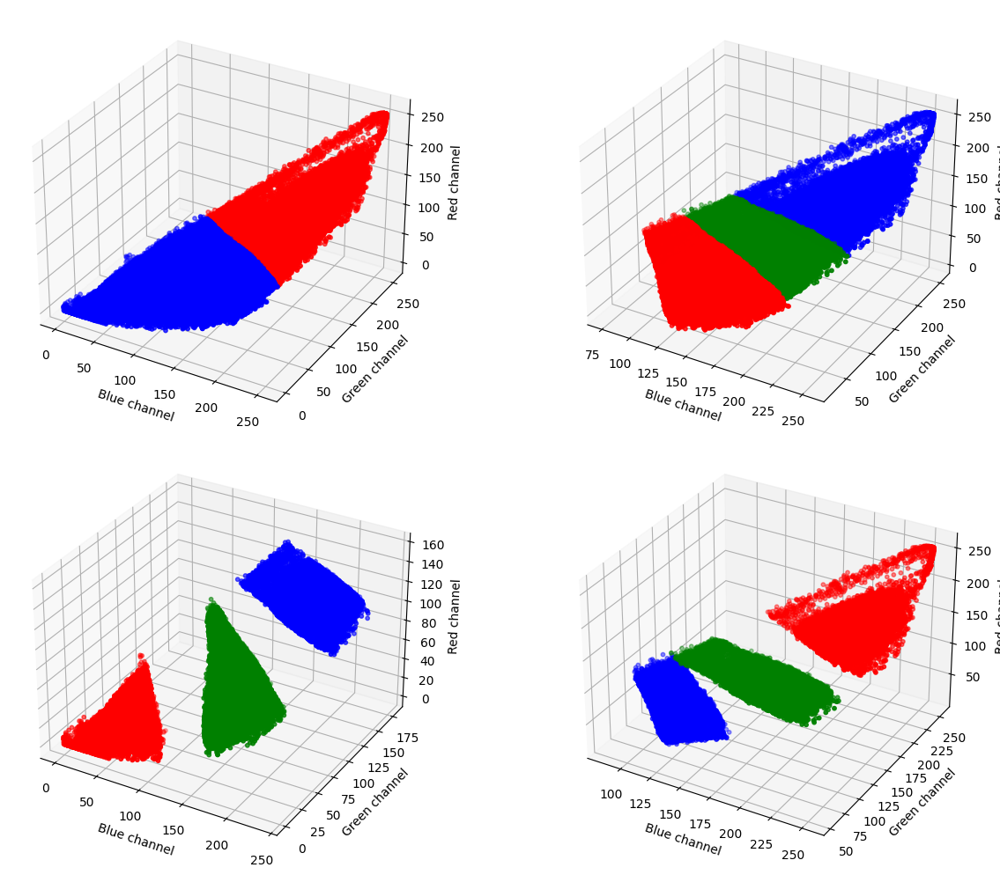

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig=plt.figure(figsize=(14,10))

ax = [fig.add_subplot(221, projection='3d'),
      fig.add_subplot(222, projection='3d'),
      fig.add_subplot(223, projection='3d'),
      fig.add_subplot(224, projection='3d')]

for plot_number,n in enumerate(n_vals):

    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    x1, y1, z1 = [np.where(clustered == x)[0] for x in [0, 1, 2]]

    plot_vals = [('r', x1),
                 ('b', y1),
                 ('g', z1),
                 ]

    for c, channel in plot_vals:
        x = matrix[channel, 0]
        y = matrix[channel, 1]
        z = matrix[channel, 2]
        ax[plot_number].scatter(x, y, z, c=c,s=10)

    ax[plot_number].set_xlabel('Blue channel')
    ax[plot_number].set_ylabel('Green channel')
    ax[plot_number].set_zlabel('Red channel')

plt.tight_layout()

<center><span style="font-size:18px;color:blue"><b>It is evident from above graph, intensity is reduced in the color space as the number of clusters are increased.</b></span></center>

<h2> Brightness normalization is a process that changes the range of pixel intensity values. Applications include photographs with poor contrast due to glare, for example. Normalization is sometimes called contrast stretching or histogram stretching. </h2>

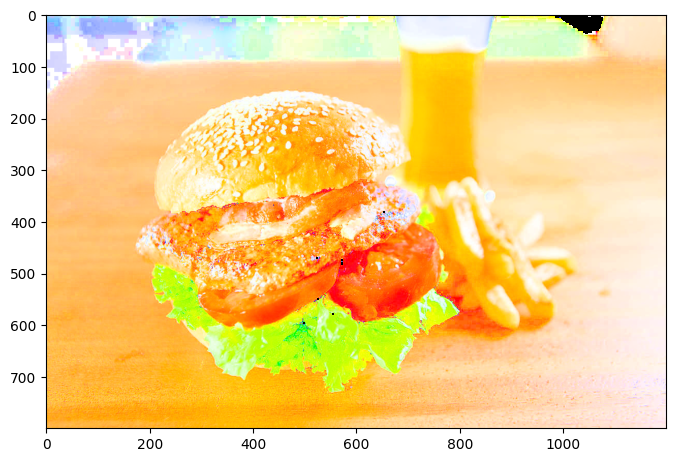

In [ ]:
bnorm = np.zeros_like(matrix, dtype=np.float32)
max_range = np.max(matrix, axis=1)
bnorm = matrix / np.vstack((max_range, max_range, max_range)).T
bnorm_img = np.reshape(bnorm, (dims[0],dims[1],dims[2]))
plt.figure(figsize=(8,10))
plt.imshow(bnorm_img)
plt.show()

 <h2> Sobel filter is a basic way to get an edge magnitude/gradient image. </h2>
    
**It works by calculating the gradient of image intensity at each pixel within the image. It finds the direction of the largest increase from light to dark and the rate of change in that direction.**

In [ ]:
pip install --upgrade pip


  Using cached pip-24.2-py3-none-any.whl.metadata (3.6 kB)
Using cached pip-24.2-py3-none-any.whl (1.8 MB)
  Attempting uninstall: pip
    Found existing installation: pip 24.1.2
    Uninstalling pip-24.1.2:
      Successfully uninstalled pip-24.1.2


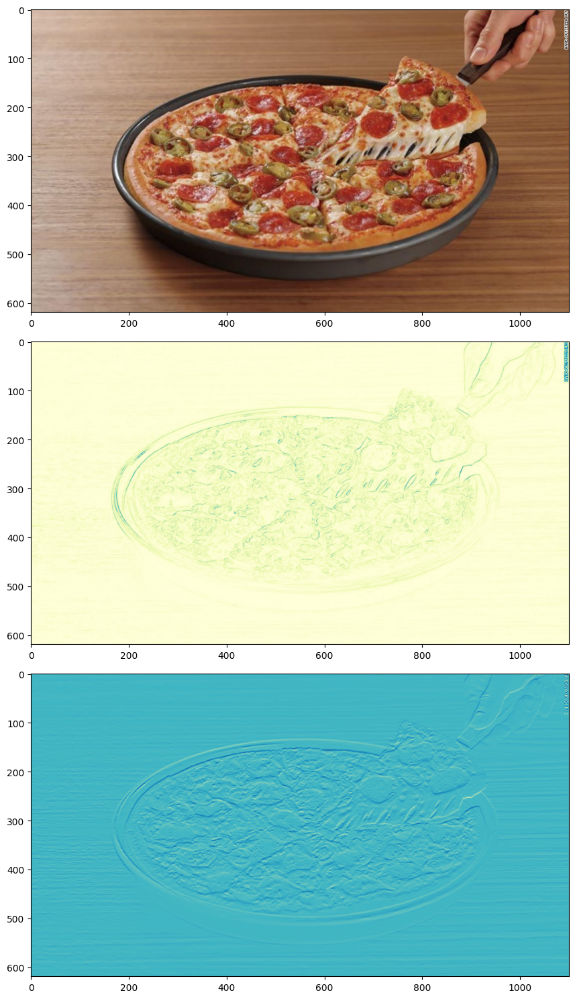

In [ ]:
import skimage
from skimage.feature import greycomatrix, greycoprops
from skimage.filters import sobel
from skimage.filters import sobel_h

plt.figure(1,figsize=(20,15))
cmap="YlGnBu"
plt.subplot(3,1,1)
plt.imshow(img)

plt.subplot(3,1,2)
plt.imshow(sobel(img[:,:,2]),cmap=cmap)

plt.subplot(3,1,3)
plt.imshow(sobel_h(img[:,:,1]), cmap=cmap)

plt.tight_layout()

<center><span style="font-size:18px;color:blue"><b>Clearly the results are fascinating. We are able to isolate object and detect the edge. </b></span></center>

<h2> Let's apply Principal Component Analysis. It is a linear dimensionality reduction technique that can be utilized for extracting information from a high-dimensional space by projecting it into a lower-dimensional sub-space.</h2>

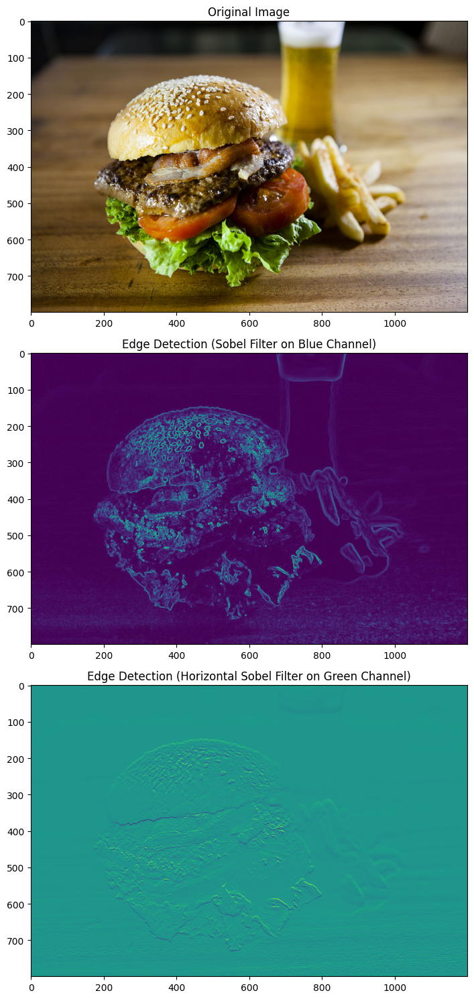

In [ ]:
import skimage
from skimage.feature import greycomatrix, greycoprops
from skimage.filters import sobel, sobel_h
import matplotlib.pyplot as plt

# Define the new color map for visualization
cmap = "viridis"

# Create a figure with a size of 20x15
plt.figure(1, figsize=(20, 15))

# First subplot: display the original image
plt.subplot(3, 1, 1)
plt.imshow(img)
plt.title('Original Image')

# Second subplot: apply the Sobel filter to the blue channel (detect edges)
plt.subplot(3, 1, 2)
plt.imshow(sobel(img[:, :, 2]), cmap=cmap)  # Sobel filter on blue channel
plt.title('Edge Detection (Sobel Filter on Blue Channel)')

# Third subplot: apply the horizontal Sobel filter to the green channel
plt.subplot(3, 1, 3)
plt.imshow(sobel_h(img[:, :, 1]), cmap=cmap)  # Sobel horizontal filter on green channel
plt.title('Edge Detection (Horizontal Sobel Filter on Green Channel)')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the final plots
plt.show()


# <b>Exploratory Data Analysis (EDA)</b>

## Let's visualize number of training examples for each food item

[Text(0, 0, 'pav_bhaji'),
 Text(0, 1, 'chapati'),
 Text(0, 2, 'jalebi'),
 Text(0, 3, 'burger'),
 Text(0, 4, 'samosa'),
 Text(0, 5, 'chole_bhature'),
 Text(0, 6, 'kaathi_rolls'),
 Text(0, 7, 'dhokla'),
 Text(0, 8, 'pizza'),
 Text(0, 9, 'idli'),
 Text(0, 10, 'kadai_paneer'),
 Text(0, 11, 'masala_dosa'),
 Text(0, 12, 'chai'),
 Text(0, 13, 'pakode'),
 Text(0, 14, 'dal_makhani'),
 Text(0, 15, 'kulfi'),
 Text(0, 16, 'fried_rice'),
 Text(0, 17, 'momos'),
 Text(0, 18, 'butter_naan'),
 Text(0, 19, 'paani_puri')]

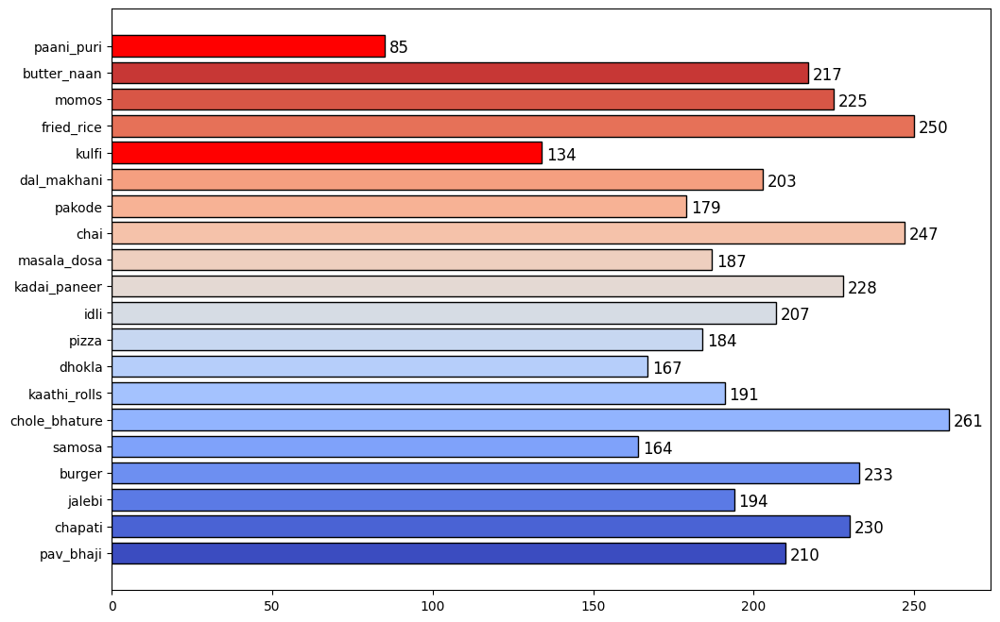

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

# Main directory containing food categories as sub-directories
main = '../indian-food-classification/dataset/Dataset/train/'

# Dictionary to store the count of images per food category
data = dict()

# Traverse each sub-directory and count the number of images
for i in os.listdir(main):
    sub_dir = os.path.join(main, i)  # Sub-directory for each food category
    count = len(os.listdir(sub_dir))  # Count the number of images in the sub-directory
    data[i] = count  # Store the count in the dictionary

# Extracting the keys (food categories) and values (image counts)
keys = list(data.keys())
values = list(data.values())

# Color customization: use a colormap for diverse colors, with red for <= 150 images
color_map = cm.get_cmap('coolwarm', len(values))  # Use a colormap (coolwarm) for diversity
colors = [color_map(i) if x > 150 else "red" for i, x in enumerate(values)]  # Assign colors

# Plotting the horizontal bar chart
fig, ax = plt.subplots(figsize=(12, 8))  # Define figure size
y_pos = np.arange(len(values))  # Y-axis positions for each category

# Create horizontal bar chart with more color diversity
plt.barh(y_pos, values, align='center', color=colors, edgecolor='black')

# Annotate each bar with the number of images
for i, v in enumerate(values):
    ax.text(v + 1.4, i - 0.25, str(v), color='black', fontsize=12)

# Set the y-axis ticks and labels
ax.set_yticks(y_pos)
ax.set_yticklabels(keys)

#


## Let's visualize our dataset by randomly picking an image from every class

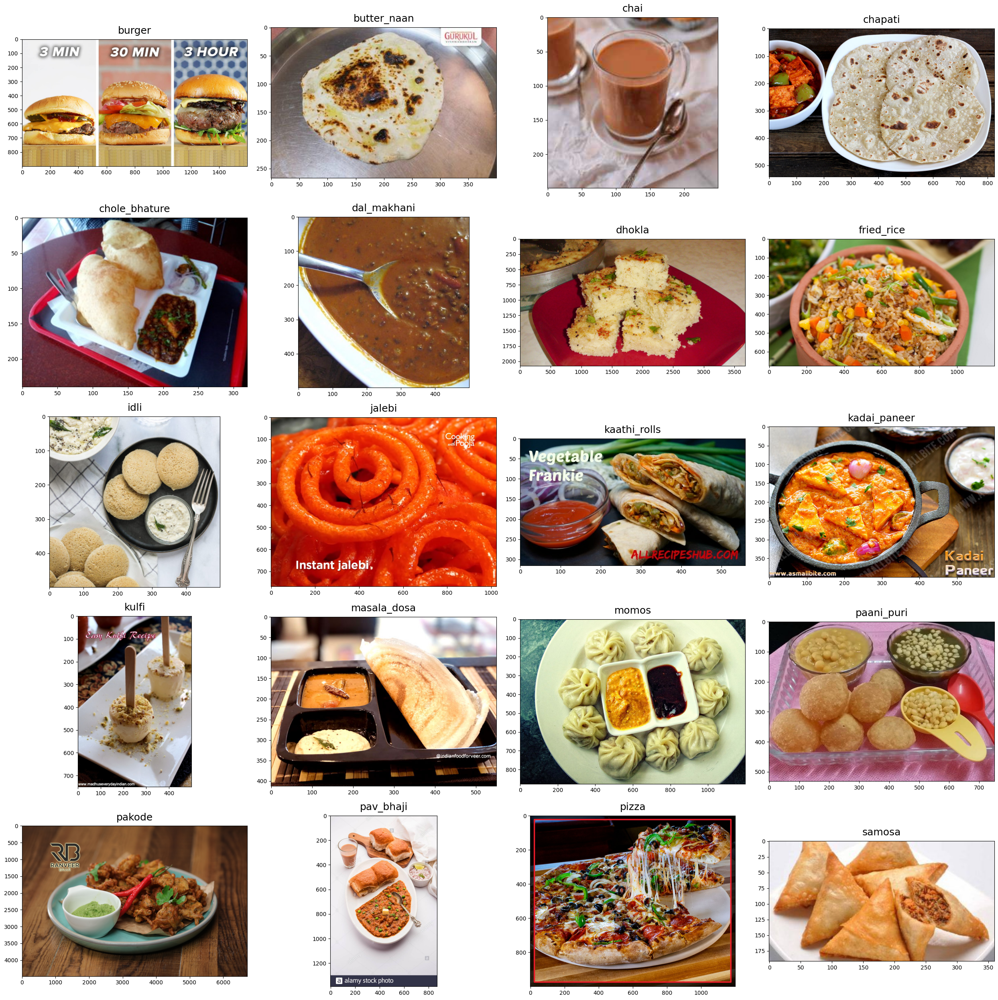

In [ ]:
import random

train_folder = "/input/indian-food-classification/dataset/Dataset/train"
images = []

for food_folder in sorted(os.listdir(train_folder)):
    food_items = os.listdir(train_folder + '/' + food_folder)
    food_selected = np.random.choice(food_items)
    images.append(os.path.join(train_folder,food_folder,food_selected))

fig=plt.figure(1, figsize=(25, 25))

for subplot,image_ in enumerate(images):
    category=image_.split('/')[-2]
    imgs = plt.imread(image_)
    a,b,c=imgs.shape
    fig=plt.subplot(5, 4, subplot+1)
    fig.set_title(category, pad = 10,size=18)
    plt.imshow(imgs)

plt.tight_layout()

<hr>

<hr>

# <b> MODEL TRAINING </b>

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

n_classes = 20
batch_size = 32
img_width, img_height = 299, 299

train_data_dir = '/input/indian-food-classification/dataset/Dataset/train'

# Data Augmentation with ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

val_data_dir = '/input/indian-food-classification/dataset/Dataset/val'

val_datagen = ImageDataGenerator(rescale=1. / 255)

val_generator = val_datagen.flow_from_directory(
    val_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 3996 images belonging to 20 classes.
Found 1250 images belonging to 20 classes.


In [ ]:
class_map = train_generator.class_indices
class_map

{'burger': 0,
 'butter_naan': 1,
 'chai': 2,
 'chapati': 3,
 'chole_bhature': 4,
 'dal_makhani': 5,
 'dhokla': 6,
 'fried_rice': 7,
 'idli': 8,
 'jalebi': 9,
 'kaathi_rolls': 10,
 'kadai_paneer': 11,
 'kulfi': 12,
 'masala_dosa': 13,
 'momos': 14,
 'paani_puri': 15,
 'pakode': 16,
 'pav_bhaji': 17,
 'pizza': 18,
 'samosa': 19}

## Training the model

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
# from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
# from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten

from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Dense, Dropout

from tensorflow.keras import regularizers
from tensorflow.keras.regularizers import l2

from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger

nb_train_samples = 3583
nb_validation_samples = 1089

inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128,activation='relu')(x)
x = Dropout(0.2)(x)

predictions = Dense(n_classes,kernel_regularizer=regularizers.l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(learning_rate=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])
checkpointer = ModelCheckpoint(filepath='v1_inceptionV3.keras', verbose=1, save_best_only=True)
csv_logger = CSVLogger('history_v1_inceptionV3.log')

history = model.fit(train_generator,
                    steps_per_epoch = nb_train_samples // batch_size,
                    validation_data=val_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=20,
                    verbose=1,
                    callbacks=[csv_logger, checkpointer])

Epoch 1/20
 35/111 ━━━━━━━━━━━━━━━━━━━━ 44:15 35s/step - accuracy: 0.0350 - loss: 3.3663

KeyboardInterrupt: 

In [ ]:
# Define your model architecture as before

from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras import regularizers
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD

# Number of classes
n_classes = 20

# Initialize the base InceptionV3 model
inception = InceptionV3(weights='imagenet', include_top=False)

# Add custom layers on top of the base InceptionV3 model
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.2)(x)

# Output layer with L2 regularization
predictions = Dense(n_classes, kernel_regularizer=regularizers.l2(0.005), activation='softmax')(x)

# Create the final model
model = Model(inputs=inception.input, outputs=predictions)

# Compile the model
model.compile(optimizer=SGD(learning_rate=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary without running the model
model.summary()


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, None, None, 3)  │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, None, None, 32) │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, None, None, 32) │             96 │ conv2d[0][0]           │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation (Activation)   │ (None, None, None, 32) │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, None, None, 32) │          9,216 │ activation[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, None, None, 32) │             96 │ conv2d_1[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_1 (Activation) │ (None, None, None, 32) │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, None, None, 64) │         18,432 │ activation_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, None, None, 64) │            192 │ conv2d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_2 (Activation) │ (None, None, None, 64) │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d             │ (None, None, None, 64) │              0 │ activation_2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, None, None, 80) │          5,120 │ max_pooling2d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, None, None, 80) │            240 │ conv2d_3[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ activation_3 (Activation) │ (None, None, None, 80) │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, None, None,     │        138,240 │ activation_3[0][0]     │
│                           │ 192)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, None, None,     │            576 │ conv2d_4[0][0]         │
│ (BatchNormalization)      │ 192)                   │                │                        │
├──────────────────────

 Total params: 22,067,636 (84.18 MB)

 Trainable params: 22,033,204 (84.05 MB)

 Non-trainable params: 34,432 (134.50 KB)

## Saving the model

In [ ]:
#Save the trained model
model.save('model_v1_inceptionV3.h5')

## Accuracy and Loss curves

In [ ]:
def plot_accuracy(history):

    plt.plot(history.history['accuracy'],label='train accuracy')
    plt.plot(history.history['val_accuracy'],label='validation accuracy')
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Accuracy_v1_InceptionV3')
    plt.show()

def plot_loss(history):

    plt.plot(history.history['loss'],label="train loss")
    plt.plot(history.history['val_loss'],label="validation loss")
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Loss_v1_InceptionV3')
    plt.show()

plot_accuracy(history)
plot_loss(history)

# <b> PREDICTIONS </b>

## Load the model

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import load_model

# Path to the saved model
path_to_model = '/input/indian-food-classification/Model/model_v1_inceptionV3.h5'

print("Loading the model..")
model = load_model(path_to_model)
print("Done!")


Loading the model..


/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:33: UserWarning: Argument `decay` is no longer supported and will be ignored.
  warnings.warn(


Done!


## Testing model on test set

In [ ]:
test_data_dir = '/input/indian-food-classification/test'

test_datagen = ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 585 images belonging to 20 classes.


In [ ]:
from tensorflow.keras.optimizers import SGD

# Re-compile the model to fix the metrics issue
model.compile(optimizer=SGD(learning_rate=0.0001, momentum=0.9),
              loss='categorical_crossentropy',
              metrics=['accuracy'])  # Make sure 'accuracy' is passed correctly

# Evaluate the model using the test generator
scores = model.evaluate(test_generator)

# Print the test accuracy
print("Test Accuracy: {:.3f}".format(scores[1]))


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


19/19 ━━━━━━━━━━━━━━━━━━━━ 158s 8s/step - accuracy: 0.8748 - loss: 0.6841
Test Accuracy: 0.867


## Function to predict single image or predict all images from a directory

In [ ]:
category={
    0: ['burger','Burger'], 1: ['butter_naan','Butter Naan'], 2: ['chai','Chai'],
    3: ['chapati','Chapati'], 4: ['chole_bhature','Chole Bhature'], 5: ['dal_makhani','Dal Makhani'],
    6: ['dhokla','Dhokla'], 7: ['fried_rice','Fried Rice'], 8: ['idli','Idli'], 9: ['jalegi','Jalebi'],
    10: ['kathi_rolls','Kaathi Rolls'], 11: ['kadai_paneer','Kadai Paneer'], 12: ['kulfi','Kulfi'],
    13: ['masala_dosa','Masala Dosa'], 14: ['momos','Momos'], 15: ['paani_puri','Paani Puri'],
    16: ['pakode','Pakode'], 17: ['pav_bhaji','Pav Bhaji'], 18: ['pizza','Pizza'], 19: ['samosa','Samosa']
}

def predict_image(filename,model):
    img_ = image.load_img(filename, target_size=(299, 299))
    img_array = image.img_to_array(img_)
    img_processed = np.expand_dims(img_array, axis=0)
    img_processed /= 255.

    prediction = model.predict(img_processed)

    index = np.argmax(prediction)

    plt.title("Prediction - {}".format(category[index][1]))
    plt.imshow(img_array)

def predict_dir(filedir,model):
    cols=5
    pos=0
    images=[]
    total_images=len(os.listdir(filedir))
    rows=total_images//cols + 1

    true=filedir.split('/')[-1]

    fig=plt.figure(1, figsize=(25, 25))

    for i in sorted(os.listdir(filedir)):
        images.append(os.path.join(filedir,i))

    for subplot,imggg in enumerate(images):
        img_ = image.load_img(imggg, target_size=(299, 299))
        img_array = image.img_to_array(img_)

        img_processed = np.expand_dims(img_array, axis=0)

        img_processed /= 255.
        prediction = model.predict(img_processed)
        index = np.argmax(prediction)

        pred=category.get(index)[0]
        if pred==true:
            pos+=1

        fig=plt.subplot(rows, cols, subplot+1)
        fig.set_title(category.get(index)[1], pad = 10,size=18)
        plt.imshow(img_array)

    acc=pos/total_images
    print("Accuracy of Test : {:.2f} ({pos}/{total})".format(acc,pos=pos,total=total_images))
    plt.tight_layout()

- <h3> Single image prediction </h3>

In [ ]:
predict_image('../input/indian-food-classification/test/burger/images (16).jpg',model)

- <h3> Predicting category </h3>

In [ ]:
predict_dir("../input/indian-food-classification/test/masala_dosa",model)

## Let's plot a confusion matrix for all the food items

In [ ]:
from sklearn.metrics import confusion_matrix
import itertools

img_width, img_height = 299, 299

def labels_confusion_matrix():
    folder_path="/input/indian-food-classification/test"

    mapping={}
    for i,j in enumerate(sorted(os.listdir(folder_path))):
        mapping[j]=i

    files=[]
    real=[]
    predicted=[]

    for i in os.listdir(folder_path):

        true=os.path.join(folder_path,i)
        true=true.split('/')[-1]
        true=mapping[true]

        for j in os.listdir(os.path.join(folder_path,i)):

            img_ = image.load_img(os.path.join(folder_path,i,j), target_size=(img_height, img_width))
            img_array = image.img_to_array(img_)
            img_processed = np.expand_dims(img_array, axis=0)
            img_processed /= 255.
            prediction = model.predict(img_processed)
            index = np.argmax(prediction)

            predicted.append(index)
            real.append(true)

    return (real,predicted)

def print_confusion_matrix(real,predicted):

    cmap="viridis"
    cm_plot_labels = [i for i in range(20)]

    cm = confusion_matrix(y_true=real, y_pred=predicted)
    df_cm = pd.DataFrame(cm,cm_plot_labels,cm_plot_labels)
    sns.set(font_scale=1.1) # for label size
    plt.figure(figsize = (15,10))
    s=sns.heatmap(df_cm, annot=True,cmap=cmap) # font size
#     bottom,top=s.get_ylim()
#     s.set_ylim(bottom+0.6,top-0.6)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig('confusion_matrix.png')
    plt.show()

19/19 ━━━━━━━━━━━━━━━━━━━━ 153s 8s/step


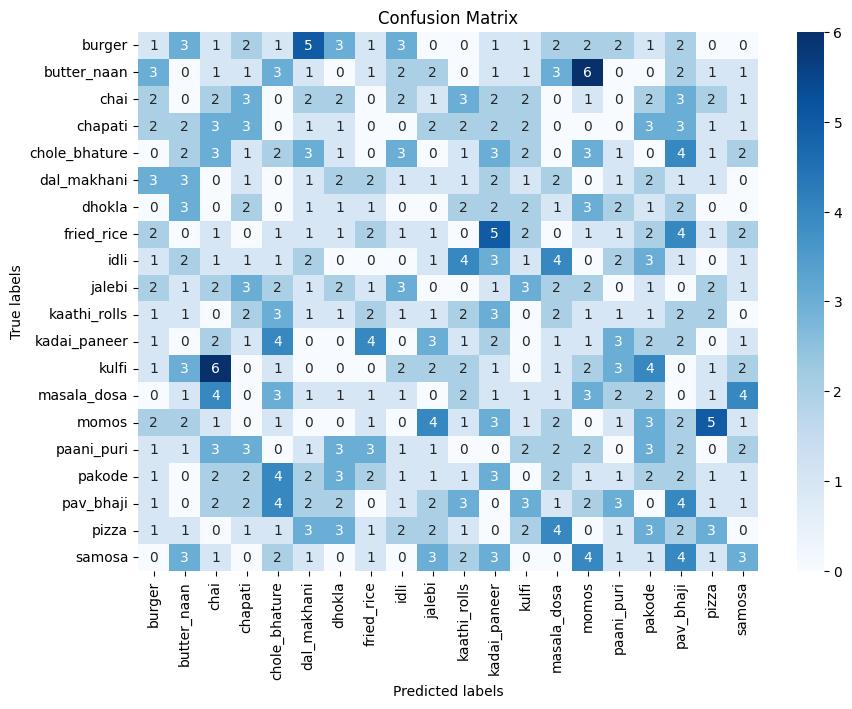

               precision    recall  f1-score   support

       burger       0.04      0.03      0.04        31
  butter_naan       0.00      0.00      0.00        29
         chai       0.06      0.07      0.06        30
      chapati       0.11      0.11      0.11        28
chole_bhature       0.06      0.06      0.06        32
  dal_makhani       0.03      0.04      0.04        25
       dhokla       0.04      0.04      0.04        23
   fried_rice       0.09      0.07      0.08        28
         idli       0.00      0.00      0.00        28
       jalebi       0.00      0.00      0.00        29
 kaathi_rolls       0.07      0.07      0.07        27
 kadai_paneer       0.05      0.07      0.06        28
        kulfi       0.00      0.00      0.00        31
  masala_dosa       0.03      0.03      0.03        29
        momos       0.00      0.00      0.00        30
   paani_puri       0.00      0.00      0.00        30
       pakode       0.06      0.06      0.06        32
    pav_b

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Get true labels and predicted labels
y_true = test_generator.classes  # True labels from the test dataset
y_pred = model.predict(test_generator)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert probabilities to class predictions

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Plot confusion matrix
def print_confusion_matrix(cm, labels):
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=labels, yticklabels=labels)
    plt.ylabel('True labels')
    plt.xlabel('Predicted labels')
    plt.title('Confusion Matrix')
    plt.show()

# Define class labels (replace with your class names)
class_labels = test_generator.class_indices.keys()

# Call the function to print the confusion matrix
print_confusion_matrix(cm, class_labels)

# Print classification report for detailed metrics
print(classification_report(y_true, y_pred_classes, target_names=class_labels))


<span style="font-size:21px;color:blue"><b>So far, So good!</b></span>
<hr>

<h1> <b> MODEL LEARNING VISUALIZATIONS </b></h1>

In [ ]:
def get_activations(img, model_activations):
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img /= 255.
    plt.imshow(img[0])
    plt.show()
    return model_activations.predict(img)

def show_activations(activations, layer_names):

    images_per_row = 16

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,:, :,col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()

def activation_conv():
    first_convlayer_activation = activations[0]
    second_convlayer_activation = activations[3]
    third_convlayer_activation = activations[6]
    f,ax = plt.subplots(1,3, figsize=(10,10))
    ax[0].imshow(first_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[0].axis('OFF')
    ax[0].set_title('Conv2d_1')
    ax[1].imshow(second_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[1].axis('OFF')
    ax[1].set_title('Conv2d_2')
    ax[2].imshow(third_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[2].axis('OFF')
    ax[2].set_title('Conv2d_3')


def get_attribution(food):

    tf.compat.v1.disable_eager_execution()

    img = image.load_img(food, target_size=(299, 299))
    img = image.img_to_array(img)
    img /= 255.
    f,ax = plt.subplots(1,3, figsize=(15,15))
    ax[0].imshow(img)

    img = np.expand_dims(img, axis=0)
    model = load_model('./model_v1_inceptionV3.h5')

    preds = model.predict(img)
    class_id = np.argmax(preds[0])
    ax[0].set_title("Input Image")
    class_output = model.output[:, class_id]
    last_conv_layer = model.get_layer("mixed10")

    grads = K.gradients(class_output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([img])
    for i in range(2048):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    ax[1].imshow(heatmap)
    ax[1].set_title("Heat map")


    act_img = cv2.imread(food)
    heatmap = cv2.resize(heatmap, (act_img.shape[1], act_img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = cv2.addWeighted(act_img, 0.6, heatmap, 0.4, 0)
    cv2.imwrite('classactivation.png', superimposed)
    img_act = image.load_img('classactivation.png', target_size=(299, 299))
    ax[2].imshow(img_act)
    ax[2].set_title("Class Activation")
    plt.show()
    return preds

## MODEL LAYERS

In [ ]:
print("Total layers in the model : ",len(model.layers),"\n")

# We start with index 1 instead of 0, as input layer is at index 0
layers = [layer.output for layer in model.layers[1:11]]
# We now initialize a model which takes an input and outputs the above chosen layers
activations_output = models.Model(inputs=model.input, outputs=layers)
# print(layers)

layer_names = []
for layer in model.layers[1:11]:
    layer_names.append(layer.name)

print("First 10 layers which we can visualize are -> ", layer_names)


<span style="font-size:18px;color:blue"><b>Our model has 315 layers with InceptionV3 architecture!</b></span>
<br><br>
<span style="font-size:18px;color:blue"><b>Whoa! That's a lot to process at first, so let's just stick with 10 layers for now and visualize these first to see how neural networks classify.</b></span>
<hr>

# <b>LAYER WISE ACTIVATIONS</b>

In [ ]:
food = '../input/indian-food-classification/dataset/Dataset/val/pizza/155.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

## Let's show the activation outputs of Conv2D layer (we have three of them in first 10 layers) to compare how layers get abstract with depth.

In [ ]:
activation_conv()

## This time let's visualize some other food item's layer.

In [ ]:
food = '../input/indian-food-classification/dataset/Dataset/val/idli/065.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

In [ ]:
activation_conv()

# <b>GENERATING HEATMAPS</b>

In [ ]:
pred = get_attribution('../input/indian-food-classification/dataset/Dataset/val/idli/065.jpg')

In [ ]:
pred2=get_attribution('../input/indian-food-classification/test/fried_rice/images (5).jpg')

In [ ]:
pred3=get_attribution('../input/indian-food-classification/test/chai/images (3).jpg')

In [ ]:
pred4=get_attribution('../input/indian-food-classification/test/jalebi/images (4).jpg')

In [ ]:
pred5=get_attribution('../input/indian-food-classification/test/chole_bhature/images (10).jpg')

## Downloading random image from net to predict and generate heatmap

In [ ]:
!wget -O download.jpg https://www.cookwithmanali.com/wp-content/uploads/2015/01/Restaurant-Style-Dal-Makhani-Recipe.jpg

model_load = load_model('./model_v1_inceptionV3.h5')

In [ ]:
pred = get_attribution('download.jpg')